In [1]:
import pandas as pd

In [2]:
df = pd.read_csv("../data/twitter-sentiment-analysis-hate-speech.csv")
df

,id,label,tweet
0,1,0,@user when a father is dysfunctional and is s...
1,2,0,@user @user thanks for #lyft credit i can't us...
2,3,0,bihday your majesty
3,4,0,#model i love u take with u all the time in ...
4,5,0,factsguide: society now #motivation
...,...,...,...
31957,31958,0,ate @user isz that youuu?ðððððð...
31958,31959,0,to see nina turner on the airwaves trying to...
31959,31960,0,listening to sad songs on a monday morning otw...
31960,31961,1,"@user #sikh #temple vandalised in in #calgary,..."


In [3]:
from nltk import WordNetLemmatizer, RegexpTokenizer, download
from nltk.corpus import stopwords

download('wordnet')
download('stopwords')

[nltk_data] Downloading package wordnet to /Users/fawad/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to /Users/fawad/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [4]:
def tweet_tokenizer(tweet):
    regex_tokenizer = RegexpTokenizer(r"\w+")
    tokenized = regex_tokenizer.tokenize(tweet)
    lowercase_tokens = [t.lower() for t in tokenized]

    lemmatizer = WordNetLemmatizer()
    lemmatized_token = [lemmatizer.lemmatize(token) for token in lowercase_tokens]

    stop_words = stopwords.words('english')
    useful_tokens = [token for token in lemmatized_token if token not in stop_words]

    return useful_tokens

In [5]:
tweet_tokenizer(df.iloc[10]['tweet'])

['â',
 'ireland',
 'consumer',
 'price',
 'index',
 'mom',
 'climbed',
 'previous',
 '0',
 '2',
 '0',
 '5',
 'may',
 'blog',
 'silver',
 'gold',
 'forex']

In [6]:
df['label'].value_counts()

label
0    29720
1     2242
Name: count, dtype: int64

In [ ]:
!wget http://downloads.cs.stanford.edu/nlp/data/glove.6B.zip

In [ ]:
!unzip glove.6B.zip

In [7]:
import numpy as np

words = dict()

def add_to_dict(d, filename):
    with open(filename, 'r') as f:
        for line in f.readlines():
            line = line.split(' ')

            try:
                d[line[0]] = np.array(line[1:], dtype=float)
            except:
                continue

add_to_dict(words, 'glove.6B.50d.txt')
words

{'the': array([ 4.1800e-01,  2.4968e-01, -4.1242e-01,  1.2170e-01,  3.4527e-01,
        -4.4457e-02, -4.9688e-01, -1.7862e-01, -6.6023e-04, -6.5660e-01,
         2.7843e-01, -1.4767e-01, -5.5677e-01,  1.4658e-01, -9.5095e-03,
         1.1658e-02,  1.0204e-01, -1.2792e-01, -8.4430e-01, -1.2181e-01,
        -1.6801e-02, -3.3279e-01, -1.5520e-01, -2.3131e-01, -1.9181e-01,
        -1.8823e+00, -7.6746e-01,  9.9051e-02, -4.2125e-01, -1.9526e-01,
         4.0071e+00, -1.8594e-01, -5.2287e-01, -3.1681e-01,  5.9213e-04,
         7.4449e-03,  1.7778e-01, -1.5897e-01,  1.2041e-02, -5.4223e-02,
        -2.9871e-01, -1.5749e-01, -3.4758e-01, -4.5637e-02, -4.4251e-01,
         1.8785e-01,  2.7849e-03, -1.8411e-01, -1.1514e-01, -7.8581e-01]),
 ',': array([ 0.013441,  0.23682 , -0.16899 ,  0.40951 ,  0.63812 ,  0.47709 ,
        -0.42852 , -0.55641 , -0.364   , -0.23938 ,  0.13001 , -0.063734,
        -0.39575 , -0.48162 ,  0.23291 ,  0.090201, -0.13324 ,  0.078639,
        -0.41634 , -0.15428 ,  0.1

In [8]:
len(words)

400000

In [9]:
def tweet_to_vector(tweet, word_vector_mapping=words):
    tweet_tokens = tweet_tokenizer(tweet=tweet)
    tweet_vectors=[]

    for token in tweet_tokens:
        if token not in word_vector_mapping:
            continue
        tweet_vector = word_vector_mapping[token]
        tweet_vectors.append(tweet_vector)

    return np.array(tweet_vectors, dtype=float)

In [10]:
tweet_to_vector(df['tweet'].iloc[0]), tweet_to_vector(df['tweet'].iloc[0]).shape 

(array([[ 6.5028e-01, -1.6910e-01,  1.1237e+00,  6.7691e-01,  5.5291e-01,
         -2.4560e-01, -3.6449e-01, -9.4084e-01,  9.1122e-01,  6.2275e-01,
          5.0429e-01,  6.9679e-01,  5.7960e-01, -1.6755e-01,  3.8266e-01,
         -2.0152e-01, -1.0036e+00,  3.9738e-02,  1.0055e+00, -9.2738e-01,
         -6.2525e-03, -4.8870e-01, -3.2331e-01,  1.2110e+00,  8.5893e-01,
         -6.3384e-01,  4.5837e-01, -5.5207e-01,  2.6687e-01, -3.6631e-01,
          2.9222e+00, -3.7146e-01, -3.0435e-01, -9.9872e-01,  1.4728e-02,
          5.3908e-01,  2.0362e-01,  7.7918e-02, -6.4787e-01, -6.5404e-01,
          1.4543e+00, -1.3311e-01, -5.6069e-01,  1.1655e+00, -5.0198e-01,
         -4.9950e-01,  1.1567e+00,  2.0633e-01,  8.9666e-01,  3.0050e-01],
        [ 9.5496e-02,  7.0418e-01, -4.0777e-01, -8.0844e-01,  1.2560e+00,
          7.7071e-01, -1.0695e+00,  7.6847e-01, -8.7813e-01, -8.0954e-03,
          4.3884e-01,  1.0476e+00, -4.5071e-01, -5.8931e-01,  8.3246e-01,
         -3.8442e-02, -7.3533e-01,  2

In [11]:
tweet_to_vector(df['tweet'].iloc[1]), tweet_to_vector(df['tweet'].iloc[1]).shape 

(array([[ 0.65028  , -0.1691   ,  1.1237   ,  0.67691  ,  0.55291  ,
         -0.2456   , -0.36449  , -0.94084  ,  0.91122  ,  0.62275  ,
          0.50429  ,  0.69679  ,  0.5796   , -0.16755  ,  0.38266  ,
         -0.20152  , -1.0036   ,  0.039738 ,  1.0055   , -0.92738  ,
         -0.0062525, -0.4887   , -0.32331  ,  1.211    ,  0.85893  ,
         -0.63384  ,  0.45837  , -0.55207  ,  0.26687  , -0.36631  ,
          2.9222   , -0.37146  , -0.30435  , -0.99872  ,  0.014728 ,
          0.53908  ,  0.20362  ,  0.077918 , -0.64787  , -0.65404  ,
          1.4543   , -0.13311  , -0.56069  ,  1.1655   , -0.50198  ,
         -0.4995   ,  1.1567   ,  0.20633  ,  0.89666  ,  0.3005   ],
        [ 0.65028  , -0.1691   ,  1.1237   ,  0.67691  ,  0.55291  ,
         -0.2456   , -0.36449  , -0.94084  ,  0.91122  ,  0.62275  ,
          0.50429  ,  0.69679  ,  0.5796   , -0.16755  ,  0.38266  ,
         -0.20152  , -1.0036   ,  0.039738 ,  1.0055   , -0.92738  ,
         -0.0062525, -0.4887   , 

In [12]:
train_df = df.sample(frac=1, random_state=1)
train_df.reset_index(drop=True, inplace=True)

split_index_1 = int(len(train_df) * 0.7)
split_index_2 = int(len(train_df) * 0.85)

train_df, val_df, test_df = train_df[:split_index_1], train_df[split_index_1:split_index_2], train_df[split_index_2:]

len(train_df), len(val_df), len(test_df)

(22373, 4794, 4795)

In [13]:
test_df['label'].value_counts()

label
0    4454
1     341
Name: count, dtype: int64

In [14]:
val_df['label'].value_counts()

label
0    4446
1     348
Name: count, dtype: int64

In [15]:
train_df['label'].value_counts()

label
0    20820
1     1553
Name: count, dtype: int64

In [16]:
def df_to_X_Y(frame: pd.DataFrame):
    y = frame['label'].to_numpy(dtype=int)
    tweet_vectors_list = []

    for tweet in frame['tweet']:
        tweet_vector = tweet_to_vector(tweet=tweet)
        if tweet_vector.shape == 0:
            tweet_vector = np.zeros(shape=(1, 50))
        tweet_vectors_list.append(tweet_vector)
    return tweet_vectors_list, y

In [17]:
X_train, y_train = df_to_X_Y(frame=train_df)
len(X_train[0]), len(X_train[1])

(8, 5)

In [18]:
X_test, y_test = df_to_X_Y(frame=test_df)
len(X_test[0]), len(X_test[1])

(1, 9)

In [19]:
X_val, y_val = df_to_X_Y(frame=val_df)
len(X_val[0]), len(X_val[1])

(9, 11)

[array([[ 6.4771e-01, -1.6463e-01,  1.9638e-01, -5.8726e-01,  6.3416e-01,
          2.3322e-02, -6.6678e-01,  4.3913e-01, -5.9603e-01,  3.5893e-02,
          2.2174e-02,  2.6466e-01, -4.7142e-02, -4.0288e-01,  1.0235e+00,
          6.8651e-01,  2.0022e-01, -2.3388e-01, -5.7263e-01, -4.2456e-01,
         -4.5872e-01, -5.5300e-01,  2.8364e-01,  4.4037e-02,  6.9875e-01,
         -1.7093e+00, -8.7817e-01,  8.7230e-02,  6.9903e-01, -1.9430e-01,
          2.9100e+00, -1.4596e-01,  9.9823e-02, -3.4960e-01,  2.7471e-01,
         -3.6583e-01,  1.5896e-01,  3.7503e-01,  7.2666e-02, -3.9181e-01,
         -5.1790e-01,  2.8242e-02, -1.0855e-02,  6.0391e-01, -9.7684e-02,
          1.8080e-01, -7.8304e-03,  4.4668e-03, -2.0534e-01,  3.9276e-01],
        [-4.8610e-03,  3.8375e-01,  9.7559e-01, -2.4330e-01,  4.1629e-01,
          1.5898e-01, -6.4181e-01, -4.1762e-01, -4.2678e-01, -3.0253e-01,
         -8.8405e-02, -1.0196e+00, -7.4540e-03, -3.2856e-01,  8.3239e-01,
         -2.8329e-01, -5.2919e-01, -4

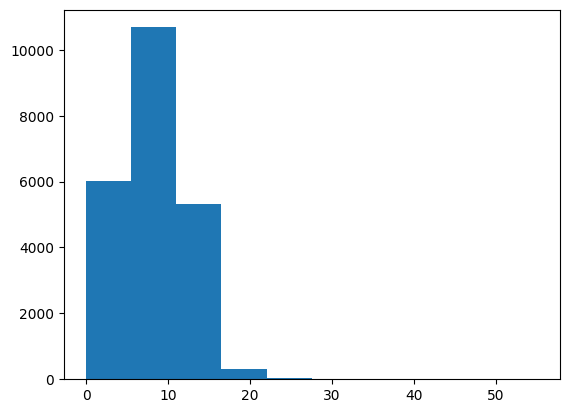

In [20]:
sequences_lengths = []

for sequence in X_train:
    sequences_lengths.append(len(sequence))

import matplotlib.pyplot as plt
plt.hist(sequences_lengths)
X_train

[array([[ 2.5436e-01, -4.4304e-01, -1.2524e-01, -5.5061e-01,  2.0468e-01,
         -5.7605e-01,  5.3126e-01,  1.9765e-01, -2.0998e-01,  4.4739e-01,
         -3.4728e-01,  3.6497e-01, -5.6163e-01, -2.0691e-01,  2.4299e-01,
          6.1507e-01,  8.9434e-01,  5.1141e-01,  4.9729e-01,  3.0724e-02,
         -7.9738e-01, -3.3084e-02,  4.8588e-01,  3.6204e-01,  1.1591e+00,
         -1.9427e-01, -1.1693e+00,  6.0489e-01,  6.8008e-01, -8.6187e-01,
         -6.7478e-01,  3.0154e-01,  8.5766e-02,  5.4609e-01,  9.1503e-02,
         -5.2176e-01, -5.5124e-02,  7.8579e-01,  3.7501e-01,  3.5525e-01,
         -2.8560e-01, -9.4147e-01,  5.9187e-02,  1.1692e+00,  9.5370e-04,
          2.9693e-01,  4.6658e-01,  7.3353e-01,  2.6198e-02,  3.0408e-01]]),
 array([[ 1.1157e-01, -1.8558e+00,  1.5797e-01, -1.3085e+00, -2.8090e-01,
         -1.1992e+00, -3.1125e-01, -1.5848e-02, -7.8890e-01,  3.0721e-01,
          6.5955e-01,  5.3228e-01, -1.3585e+00, -6.0038e-01,  4.8705e-01,
          6.0296e-01,  7.7603e-01, 

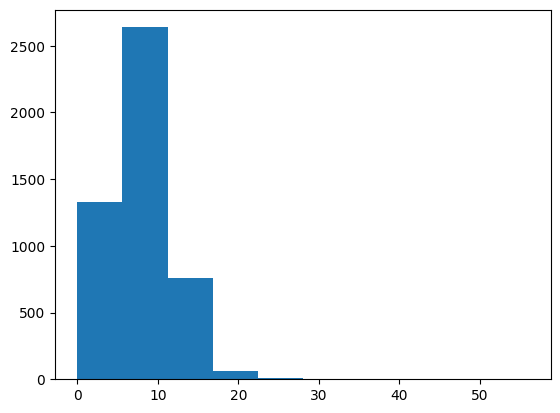

In [21]:
sequences_lengths = []

for sequence in X_test:
    sequences_lengths.append(len(sequence))

plt.hist(sequences_lengths)
X_test

[array([[ 6.5028e-01, -1.6910e-01,  1.1237e+00,  6.7691e-01,  5.5291e-01,
         -2.4560e-01, -3.6449e-01, -9.4084e-01,  9.1122e-01,  6.2275e-01,
          5.0429e-01,  6.9679e-01,  5.7960e-01, -1.6755e-01,  3.8266e-01,
         -2.0152e-01, -1.0036e+00,  3.9738e-02,  1.0055e+00, -9.2738e-01,
         -6.2525e-03, -4.8870e-01, -3.2331e-01,  1.2110e+00,  8.5893e-01,
         -6.3384e-01,  4.5837e-01, -5.5207e-01,  2.6687e-01, -3.6631e-01,
          2.9222e+00, -3.7146e-01, -3.0435e-01, -9.9872e-01,  1.4728e-02,
          5.3908e-01,  2.0362e-01,  7.7918e-02, -6.4787e-01, -6.5404e-01,
          1.4543e+00, -1.3311e-01, -5.6069e-01,  1.1655e+00, -5.0198e-01,
         -4.9950e-01,  1.1567e+00,  2.0633e-01,  8.9666e-01,  3.0050e-01],
        [ 4.8642e-01,  1.9708e-02,  1.6084e-01, -2.8113e-01,  8.9912e-01,
         -5.1431e-01, -1.0537e+00,  2.6241e-02, -1.2318e-01, -4.8724e-02,
         -2.1479e-01,  1.0296e-01, -5.9197e-01,  5.4850e-01,  4.1899e-01,
          4.9074e-01,  2.5940e-01, -2

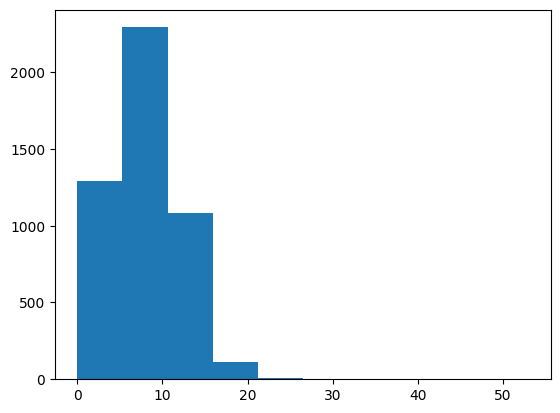

In [22]:
sequences_lengths = []

for sequence in X_val:
    sequences_lengths.append(len(sequence))

plt.hist(sequences_lengths)
X_val

In [25]:
from copy import deepcopy
def pad_X(X, desired_sequence_length=57):
    X_copy = deepcopy(X)
    padded_X = []
    for x in X_copy:
        x_seq_len = x.shape[0]
        sequence_length_difference = desired_sequence_length - x_seq_len

        if x_seq_len == 0:
            # Handle empty sequences
            x = np.zeros((desired_sequence_length, 50))
        elif sequence_length_difference > 0:
            # Pad sequences shorter than desired length
            pad = np.zeros((sequence_length_difference, 50))
            x = np.concatenate([x, pad])
        elif sequence_length_difference < 0:
            # Truncate sequences longer than desired length
            x = x[:desired_sequence_length]

        padded_X.append(x)

    return np.array(padded_X).astype(float)

In [26]:
X_train = pad_X(X=X_train)
X_train.shape

(22373, 57, 50)

In [27]:
X_test = pad_X(X=X_test)
X_test.shape

(4795, 57, 50)

In [28]:
X_val = pad_X(X_val)
X_val.shape

(4794, 57, 50)

In [32]:
X_train

array([[[ 0.64771  , -0.16463  ,  0.19638  , ...,  0.0044668,
         -0.20534  ,  0.39276  ],
        [-0.004861 ,  0.38375  ,  0.97559  , ..., -0.5171   ,
          0.028975 ,  0.10963  ],
        [ 0.02648  ,  0.33737  ,  0.065667 , ..., -0.3398   ,
         -0.23043  ,  0.19069  ],
        ...,
        [ 0.       ,  0.       ,  0.       , ...,  0.       ,
          0.       ,  0.       ],
        [ 0.       ,  0.       ,  0.       , ...,  0.       ,
          0.       ,  0.       ],
        [ 0.       ,  0.       ,  0.       , ...,  0.       ,
          0.       ,  0.       ]],

       [[-1.1949   ,  0.053218 ,  0.0030949, ..., -0.55003  ,
          0.41548  , -0.34975  ],
        [-0.70129  , -0.13413  , -0.57914  , ..., -0.56707  ,
          0.009268 , -0.78526  ],
        [ 0.032332 ,  0.046372 , -0.15943  , ..., -0.27707  ,
         -0.74855  ,  0.77501  ],
        ...,
        [ 0.       ,  0.       ,  0.       , ...,  0.       ,
          0.       ,  0.       ],
        [ 0.

In [33]:
X_test

array([[[ 0.25436 , -0.44304 , -0.12524 , ...,  0.73353 ,  0.026198,
          0.30408 ],
        [ 0.      ,  0.      ,  0.      , ...,  0.      ,  0.      ,
          0.      ],
        [ 0.      ,  0.      ,  0.      , ...,  0.      ,  0.      ,
          0.      ],
        ...,
        [ 0.      ,  0.      ,  0.      , ...,  0.      ,  0.      ,
          0.      ],
        [ 0.      ,  0.      ,  0.      , ...,  0.      ,  0.      ,
          0.      ],
        [ 0.      ,  0.      ,  0.      , ...,  0.      ,  0.      ,
          0.      ]],

       [[ 0.11157 , -1.8558  ,  0.15797 , ...,  0.48485 , -0.63317 ,
         -0.27842 ],
        [ 0.66071 , -0.71669 , -0.51879 , ..., -0.65999 ,  0.050458,
          0.24406 ],
        [-0.20784 , -0.80485 ,  0.10014 , ..., -0.57778 ,  0.17871 ,
          0.59466 ],
        ...,
        [ 0.      ,  0.      ,  0.      , ...,  0.      ,  0.      ,
          0.      ],
        [ 0.      ,  0.      ,  0.      , ...,  0.      ,  0.      ,
   

In [34]:
X_val

array([[[ 0.65028  , -0.1691   ,  1.1237   , ...,  0.20633  ,
          0.89666  ,  0.3005   ],
        [ 0.48642  ,  0.019708 ,  0.16084  , ..., -0.050574 ,
          0.19356  ,  0.17562  ],
        [-0.25187  , -0.059678 ,  0.23937  , ...,  0.5704   ,
          0.14684  , -0.035119 ],
        ...,
        [ 0.       ,  0.       ,  0.       , ...,  0.       ,
          0.       ,  0.       ],
        [ 0.       ,  0.       ,  0.       , ...,  0.       ,
          0.       ,  0.       ],
        [ 0.       ,  0.       ,  0.       , ...,  0.       ,
          0.       ,  0.       ]],

       [[-0.8316   , -0.28532  , -0.16914  , ..., -0.4715   ,
          0.13082  , -0.24228  ],
        [ 0.67806  , -0.19935  ,  1.4102   , ..., -0.24438  ,
         -0.39293  , -1.1229   ],
        [ 0.088417 , -0.09041  , -0.95651  , ..., -1.4912   ,
         -0.59472  , -0.20404  ],
        ...,
        [ 0.       ,  0.       ,  0.       , ...,  0.       ,
          0.       ,  0.       ],
        [ 0.

In [30]:
y_train.shape, y_test.shape, y_val.shape

((22373,), (4795,), (4794,))

In [45]:
from tensorflow.keras.models import Sequential, load_model
from tensorflow.keras.layers import Input, LSTM, Dense, Flatten, Dropout
from tensorflow.keras.losses import BinaryCrossentropy
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.metrics import AUC

In [46]:
model = Sequential([])

model.add(Input(shape=(57, 50)))
model.add(LSTM(64, return_sequences=True))
model.add(Dropout(0.2))
model.add(LSTM(64, return_sequences=True))
model.add(Dropout(0.2))
model.add(LSTM(64, return_sequences=True))
model.add(Dropout(0.2))
model.add(Flatten())
model.add(Dense(1, activation='sigmoid'))

model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm (LSTM)                     │ (None, 57, 64)         │        29,440 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 57, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_1 (LSTM)                   │ (None, 57, 64)         │        33,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 57, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_2 (LSTM)                   │ (None, 57, 64)         │        33,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 57, 64)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 3648)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 1)              │         3,649 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 99,137 (387.25 KB)

 Trainable params: 99,137 (387.25 KB)

 Non-trainable params: 0 (0.00 B)

In [49]:
cp = ModelCheckpoint('../model/lstm_sentiment.keras', save_best_only=True)
model.compile(optimizer=Adam(learning_rate=0.0001), loss=BinaryCrossentropy(), metrics=['accuracy', AUC(name='auc')])

In [52]:
from warnings import filterwarnings

filterwarnings('ignore')

frequencies = pd.value_counts(train_df['label'])
frequencies

label
0    20820
1     1553
Name: count, dtype: int64

In [53]:
weights = {0: frequencies.sum() / frequencies[0], 1: frequencies.sum() / frequencies[1]}
weights

{0: 1.0745917387127761, 1: 14.406310367031551}

In [54]:
model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=20, callbacks=[cp], class_weight=weights)

Epoch 1/20
700/700 ━━━━━━━━━━━━━━━━━━━━ 91s 118ms/step - accuracy: 0.6592 - auc: 0.7958 - loss: 1.1294 - val_accuracy: 0.8212 - val_auc: 0.8876 - val_loss: 0.4169
Epoch 2/20
700/700 ━━━━━━━━━━━━━━━━━━━━ 392s 560ms/step - accuracy: 0.8168 - auc: 0.8894 - loss: 0.8234 - val_accuracy: 0.8602 - val_auc: 0.8971 - val_loss: 0.3528
Epoch 3/20
700/700 ━━━━━━━━━━━━━━━━━━━━ 147s 124ms/step - accuracy: 0.8289 - auc: 0.8928 - loss: 0.8000 - val_accuracy: 0.8550 - val_auc: 0.9041 - val_loss: 0.3205
Epoch 4/20
700/700 ━━━━━━━━━━━━━━━━━━━━ 82s 117ms/step - accuracy: 0.8196 - auc: 0.9085 - loss: 0.7742 - val_accuracy: 0.8571 - val_auc: 0.9098 - val_loss: 0.3270
Epoch 5/20
700/700 ━━━━━━━━━━━━━━━━━━━━ 82s 117ms/step - accuracy: 0.8389 - auc: 0.9177 - loss: 0.7169 - val_accuracy: 0.7881 - val_auc: 0.9111 - val_loss: 0.4596
Epoch 6/20
700/700 ━━━━━━━━━━━━━━━━━━━━ 143s 118ms/step - accuracy: 0.8382 - auc: 0.9251 - loss: 0.6939 - val_accuracy: 0.8340 - val_auc: 0.9148 - val_loss: 0.3675
Epoch 7/20
700/700 

In [55]:
best_model = load_model('../model/lstm_sentiment.keras')

In [56]:
from sklearn.metrics import classification_report

test_predictions = (best_model.predict(X_test) > 0.5).astype(int)
print(classification_report(y_test, test_predictions))

150/150 ━━━━━━━━━━━━━━━━━━━━ 7s 41ms/step
              precision    recall  f1-score   support

           0       0.98      0.90      0.94      4454
           1       0.39      0.79      0.52       341

    accuracy                           0.90      4795
   macro avg       0.69      0.85      0.73      4795
weighted avg       0.94      0.90      0.91      4795



Here’s a comprehensive analysis of model training and performance:

### Observations:

1. **Class Imbalance**:  
   - The dataset is highly imbalanced (`0: 20820` vs. `1: 1553`), and we addressed this by using **class weights** (`{0: 1.07, 1: 14.40}`), which is crucial for helping the model pay more attention to the minority class (`1`).

2. **Metrics During Training**:  
   - The training process shows consistent improvement in accuracy, AUC, and loss for both training and validation datasets, indicating proper learning and no major signs of overfitting.
   - Validation AUC remains stable and high (around `0.93`), demonstrating that the model effectively distinguishes between classes.

3. **Testing Performance**:  
   - **Precision, Recall, and F1-Score**:
     - For class `0`, precision and recall are excellent (`0.98` and `0.90`).
     - For class `1`, the model struggles with precision (`0.39`) but achieves relatively high recall (`0.79`), indicating it catches most positive cases but also generates many false positives.

4. **Weighted Average Metrics**:
   - The overall weighted precision, recall, and F1-scores (`0.94`, `0.90`, `0.91`, respectively) are skewed by the dominance of class `0`.

---

### Key Issues Identified:

1. **Low Precision for Minority Class (`1`)**:
   - High recall with low precision for class `1` indicates many false positives. This is likely due to the significant class imbalance.

2. **Imbalanced F1-Scores**:
   - The F1-score for class `0` (`0.94`) is much higher than for class `1` (`0.52`), showing the model is biased toward the majority class despite the use of class weights.

3. **Possible Overemphasis on Accuracy**:
   - Accuracy (`90%`) is less meaningful in imbalanced datasets because it can be dominated by the majority class.

---

### Suggestions for Improvement:

1. **Explore Alternative Loss Functions**:
   - Use **focal loss** instead of binary cross-entropy. Focal loss reduces the impact of well-classified examples and focuses on hard-to-classify cases (like class `1` here).

2. **Data-Level Balancing**:
   - Try **oversampling** the minority class (`1`) or **undersampling** the majority class (`0`) using techniques like SMOTE or ADASYN before training.

3. **Threshold Tuning**:
   - The default threshold of `0.5` for classification might not be optimal. Use the **ROC curve** to find a threshold that balances precision and recall for class `1`.

4. **Evaluate Using Other Metrics**:
   - Consider using **precision-recall (PR) AUC** in addition to ROC AUC since PR AUC is more informative for imbalanced datasets.

5. **Adjust Model Complexity**:
   - Experiment with increasing or decreasing the number of LSTM layers, units, or dropout rates to find a better balance between underfitting and overfitting.

6. **Fine-Tune Class Weights**:
   - Instead of computing weights directly from frequencies, fine-tune them using cross-validation to find a balance between precision and recall for class `1`.

7. **Augment Data**:
   - If possible, generate more data for the minority class using data augmentation techniques or synthetic data generation.

8. **Ensemble Models**:
   - Combine predictions from multiple models (e.g., LSTM, Random Forest, etc.) to mitigate the bias toward the majority class.

---

### Next Steps:

- **Visualize Model Performance**:
  - Plot the **confusion matrix** to identify specific areas where the model is making errors.
  - Generate **PR and ROC curves** to analyze the trade-offs between precision, recall, and AUC for class `1`.

- **Re-train and Test with Adjustments**:
  - Apply some of the above techniques (focal loss, threshold tuning, or oversampling) and re-evaluate the test set.

| Platform   | Link                                           |
|------------|------------------------------------------------|
| GitHub     | [JackTheProgrammer](https://github.com/JackTheProgrammer) |
| LinkedIn   | [Fawad Awan](https://www.linkedin.com/in/fawad-awan-893a58171/) |